Modified a part of the code of https://github.com/rlvaugh/Impractical_Python_Projects to work with Colab

Removed some docstrings and variables or changed them to Japanese

# Chap1

In [1]:
import sys
VOWELS = 'aeiouy'
# word = input('なんか単語入れる')
word = 'ixnay on the ottenray'
if word[0] in VOWELS:
    pig_Latin = word + 'way'
else:
    pig_Latin = word[1:] + word[0] + 'ay'
print()
print("{}".format(pig_Latin), file=sys.stderr)

ixnay on the ottenrayway


In [2]:
import sys
import pprint
from collections import defaultdict
import string
text = 'Take the first step in faith. You don’t have to see the whole staircase, just take the first step.'
ALPHABET = string.ascii_lowercase

d = defaultdict(list)
for character in text:
    c = character.lower()
    if c in ALPHABET:
        d[c].append(c)
pprint.pprint(d, width=110)

defaultdict(<class 'list'>,
            {'a': ['a', 'a', 'a', 'a', 'a', 'a'],
             'c': ['c'],
             'd': ['d'],
             'e': ['e', 'e', 'e', 'e', 'e', 'e', 'e', 'e', 'e', 'e', 'e', 'e'],
             'f': ['f', 'f', 'f'],
             'h': ['h', 'h', 'h', 'h', 'h', 'h'],
             'i': ['i', 'i', 'i', 'i', 'i'],
             'j': ['j'],
             'k': ['k', 'k'],
             'l': ['l'],
             'n': ['n', 'n'],
             'o': ['o', 'o', 'o', 'o'],
             'p': ['p', 'p'],
             'r': ['r', 'r', 'r'],
             's': ['s', 's', 's', 's', 's', 's', 's', 's'],
             't': ['t', 't', 't', 't', 't', 't', 't', 't', 't', 't', 't', 't', 't', 't'],
             'u': ['u', 'u'],
             'v': ['v'],
             'w': ['w'],
             'y': ['y']})


# Chap2

In [3]:
# aとi以外を取り除く
word_list = ['my', 'pet', 'is', 'a', 'dog', 'b', 'c']
clean = []
ok = ('a', 'i')
for w in word_list:
    if len(w) > 1:
        clean.append(w)
    elif len(w) == 1 and w in ok:
        clean.append(w)
    else:
        continue

print(clean)

['my', 'pet', 'is', 'a', 'dog']


# Chap3


In [4]:
# 必要なファイルをダウンロードする
!wget https://raw.githubusercontent.com/en-wl/wordlist/master/alt12dicts/2of4brif.txt

--2020-08-20 10:44:17--  https://raw.githubusercontent.com/en-wl/wordlist/master/alt12dicts/2of4brif.txt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 563527 (550K) [text/plain]
Saving to: ‘2of4brif.txt’

2of4brif.txt        100%[===================>] 550.32K  --.-KB/s    in 0.07s   

2020-08-20 10:44:17 (7.86 MB/s) - ‘2of4brif.txt’ saved [563527/563527]



In [5]:
import sys
import re
from collections import defaultdict
from itertools import permutations

def load(file):
    with open(file) as f:
        txt = f.read().strip().split('\n')
        txt = [x.lower() for x in txt]
        return txt

word_list = load('2of4brif.txt')

name = 'Voldemort'  #(tmvoordle)
name = name.lower()

# generate unique letter pairs from name
digrams = set()
perms = {''.join(i) for i in permutations(name)}
for perm in perms:
    for i in range(0, len(perm) - 1):
        digrams.add(perm[i] + perm[i + 1])
print(*digrams, sep='\n')
print("\nNumber of digrams = {}\n".format(len(digrams)))

# use regular expressions to find repeating digrams in a word
mapped = defaultdict(int)
for word in word_list:
    word = word.lower()
    for digram in digrams:
        for m in re.finditer(digram, word):
            mapped[digram] += 1

print("digram frequency count:")
count = 0
for k in mapped:
    print("{} {}".format(k, mapped[k]))

rv
em
dv
or
mo
ol
lm
oo
dl
ve
mt
to
rd
lt
dr
et
tr
dm
md
vr
lr
me
ev
te
ed
ld
ov
de
rm
ot
vo
vl
el
od
dt
ro
vd
mv
er
lv
tl
vm
vt
mr
le
eo
tm
rl
om
rt
lo
re
do
oe
td
tv
ml

Number of digrams = 57

digram frequency count:
dv 78
rd 955
lo 2312
do 928
ed 7287
me 2460
em 1571
te 6856
to 2022
ot 1335
ev 648
re 6650
om 1773
or 3970
er 9875
et 2240
de 3861
tl 656
le 4935
rm 812
od 809
ol 2070
rt 1474
ve 2755
ov 796
el 2591
ro 3168
lv 138
tr 2586
dl 547
mo 1531
dr 601
tm 136
dm 100
lt 500
oo 1474
eo 365
vo 419
rl 394
lm 156
ml 58
ld 457
oe 267
lr 29
mr 16
dt 22
rv 287
vr 18
mv 7
td 27
mt 4
md 5
tv 4
vl 2


# Chap4


In [6]:
from math import factorial
from itertools import permutations, product
# nの設定
pattern_num= 4
p = [x for x in range(1, pattern_num+1)]
print("pattern = {}".format(c))

# 負の順列も考慮するため
def perms(columns):
    results = []
    for perm in permutations(columns):
        for signs in product([-1, 1], repeat=len(columns)):
            results.append([i*sign for i, sign in zip(perm, signs)])
    return results

comb = perms(p)
print("pattern数 = {}".format(len(comb)))
print(*comb, sep="\n")  # comment-out for num_cols > 4!

pattern = .
pattern数 = 384
[-1, -2, -3, -4]
[-1, -2, -3, 4]
[-1, -2, 3, -4]
[-1, -2, 3, 4]
[-1, 2, -3, -4]
[-1, 2, -3, 4]
[-1, 2, 3, -4]
[-1, 2, 3, 4]
[1, -2, -3, -4]
[1, -2, -3, 4]
[1, -2, 3, -4]
[1, -2, 3, 4]
[1, 2, -3, -4]
[1, 2, -3, 4]
[1, 2, 3, -4]
[1, 2, 3, 4]
[-1, -2, -4, -3]
[-1, -2, -4, 3]
[-1, -2, 4, -3]
[-1, -2, 4, 3]
[-1, 2, -4, -3]
[-1, 2, -4, 3]
[-1, 2, 4, -3]
[-1, 2, 4, 3]
[1, -2, -4, -3]
[1, -2, -4, 3]
[1, -2, 4, -3]
[1, -2, 4, 3]
[1, 2, -4, -3]
[1, 2, -4, 3]
[1, 2, 4, -3]
[1, 2, 4, 3]
[-1, -3, -2, -4]
[-1, -3, -2, 4]
[-1, -3, 2, -4]
[-1, -3, 2, 4]
[-1, 3, -2, -4]
[-1, 3, -2, 4]
[-1, 3, 2, -4]
[-1, 3, 2, 4]
[1, -3, -2, -4]
[1, -3, -2, 4]
[1, -3, 2, -4]
[1, -3, 2, 4]
[1, 3, -2, -4]
[1, 3, -2, 4]
[1, 3, 2, -4]
[1, 3, 2, 4]
[-1, -3, -4, -2]
[-1, -3, -4, 2]
[-1, -3, 4, -2]
[-1, -3, 4, 2]
[-1, 3, -4, -2]
[-1, 3, -4, 2]
[-1, 3, 4, -2]
[-1, 3, 4, 2]
[1, -3, -4, -2]
[1, -3, -4, 2]
[1, -3, 4, -2]
[1, -3, 4, 2]
[1, 3, -4, -2]
[1, 3, -4, 2]
[1, 3, 4, -2]
[1, 3, 4, 2]
[-1, -4, -2, 

# Chap5


In [7]:
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_5/colchester_message.txt

--2020-08-20 10:44:29--  https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_5/colchester_message.txt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 224 [text/plain]
Saving to: ‘colchester_message.txt’

colchester_message. 100%[===================>]     224  --.-KB/s    in 0s      

2020-08-20 10:44:29 (16.0 MB/s) - ‘colchester_message.txt’ saved [224/224]



In [8]:
import sys

def load(file):
    with open(file) as f:
        return f.read().strip()

# filename = input()
message = load('colchester_message.txt')

# check loaded message & # of lines
print("\nORIGINAL MESSAGE = {}\n".format(message))

# convert message to list and get length
message = message.split()
end = len(message)
# increment = int(input())
increment = 3  
for i in range(1, increment + 1):
    msg = list() 
    print('{}単語目の{}文字目'.format(i, i))
    count = i - 1
    location = i - 1
    for index, word in enumerate(message):
        if index == count:
            if location < len(word):
                msg.append(word[location])
                count += i
            else:
                print("Interval doesn't work", file=sys.stderr)
    
    print(*msg, sep='')
        


ORIGINAL MESSAGE = Sir John:  Odd and too hard, your lot.  Still, we will band together and, like you, persevere. 
Who else could love their enemies, stand firm when all others fail, hate and despair? 
While we all can, let us feel hope. -R.T.

1単語目の1文字目
SJOathylSwwbtalypWecltesfwaofhadWwaclufh-
2単語目の2文字目
onaoeanohohthtaeeaso
3単語目の3文字目
drinkovaltine


# Chap6

In [9]:
!wget https://github.com/rlvaugh/Impractical_Python_Projects/raw/master/Chapter_6/realMessageChallenge.docx

--2020-08-20 10:44:37--  https://github.com/rlvaugh/Impractical_Python_Projects/raw/master/Chapter_6/realMessageChallenge.docx
Resolving github.com (github.com)... 140.82.114.3
Connecting to github.com (github.com)|140.82.114.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_6/realMessageChallenge.docx [following]
--2020-08-20 10:44:37--  https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_6/realMessageChallenge.docx
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 13448 (13K) [application/octet-stream]
Saving to: ‘realMessageChallenge.docx’

realMessageChalleng 100%[===================>]  13.13K  --.-KB/s    in 0.01s

In [10]:
!wget https://github.com/rlvaugh/Impractical_Python_Projects/raw/master/Chapter_6/fakeMessage.docx

--2020-08-20 10:44:40--  https://github.com/rlvaugh/Impractical_Python_Projects/raw/master/Chapter_6/fakeMessage.docx
Resolving github.com (github.com)... 140.82.112.4
Connecting to github.com (github.com)|140.82.112.4|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_6/fakeMessage.docx [following]
--2020-08-20 10:44:40--  https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_6/fakeMessage.docx
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 12324 (12K) [application/octet-stream]
Saving to: ‘fakeMessage.docx’

fakeMessage.docx    100%[===================>]  12.04K  --.-KB/s    in 0s      

2020-08-20 10:44:40 (105 MB/s) 

In [11]:
!pip install python-docx

     |████████████████████████████████| 5.5MB 2.8MB/s 
  Created wheel for python-docx: filename=python_docx-0.8.10-cp36-none-any.whl size=184491 sha256=8f5cb487734e318edc8a42f9a1bdc9603bbae74335564c9515995440f839270b
  Stored in directory: /root/.cache/pip/wheels/18/0b/a0/1dd62ff812c857c9e487f27d80d53d2b40531bec1acecfa47b
Successfully built python-docx


In [12]:
import sys
import docx
from docx.shared import RGBColor, Pt

fake_text = docx.Document('fakeMessage.docx')
fake_list = []
for paragraph in fake_text.paragraphs:
    fake_list.append(paragraph.text)

real_text = docx.Document('realMessageChallenge.docx')
real_list = []
for paragraph in real_text.paragraphs:
    if len(paragraph.text) != 0:
        real_list.append(paragraph.text)

def line_limit(fake, real):
    num_blanks = 0
    num_real = 0
    for line in fake:
        if line == '':
            num_blanks += 1
    num_real = len(real)
    diff = num_real - num_blanks
    print("\nNumber of blank lines in fake message = {}".format(num_blanks))
    print("Number of lines in real message = {}\n".format(num_real))
    if num_real > num_blanks:
        print("Fake message needs {} more blank lines."
              .format(diff), file=sys.stderr)
        sys.exit()

line_limit(fake_list, real_list)
    
# load template that sets style, font, margins, etc.
doc = docx.Document('template.docx')

# add letterhead
doc.add_heading('Morland Holmes', 0)
subtitle = doc.add_heading('Global Consultanting & Negotiations', 1)
subtitle.alignment = 1 
doc.add_heading('', 1)
doc.add_paragraph('December 17, 2015')
doc.add_paragraph('')

def set_spacing(paragraph):
    """Use docx to set line spacing between paragraphs."""
    paragraph_format = paragraph.paragraph_format
    paragraph_format.space_before = Pt(0)
    paragraph_format.space_after = Pt(0)

length_real = len(real_list)
count_real = 0  # index of current line in real (hidden) message

# interleave real and fake message lines
for line in fake_list:
    if count_real < length_real and line == "":
        paragraph = doc.add_paragraph(real_list[count_real])
        paragraph_index = len(doc.paragraphs) - 1
        
        # set real message color to white
        run = doc.paragraphs[paragraph_index].runs[0]   
        font = run.font
        font.color.rgb = RGBColor(255, 255, 255)  # make it red to test
        count_real += 1
        
    else:
        paragraph = doc.add_paragraph(line)
        
    set_spacing(paragraph)

doc.save('ciphertext_message_letterhead.docx')

print("Done")


Number of blank lines in fake message = 8
Number of lines in real message = 24



Fake message needs 16 more blank lines.


SystemExit: ignored

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2890: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


# Chap7

In [13]:
import time
import random 
import statistics

# 50000g
GOAL = 50000
NUM_RATS = 20
INITIAL_MIN_WT = 200
INITIAL_MAX_WT = 600
INITIAL_MODE_WT = 300
MUTATE_ODDS = 0.01
MUTATE_MIN = 0.5
MUTATE_MAX = 1.2
LITTER_SIZE = 8
LITTERS_PER_YEAR = 10
GENERATION_LIMIT = 500

# 前処理
if NUM_RATS % 2 != 0:
    NUM_RATS += 1

def populate(num_rats, min_wt, max_wt, mode_wt):
    # 母集団の体重の初期化（triangular）
    return [int(random.triangular(min_wt, max_wt, mode_wt))\
            for i in range(num_rats)]

def fitness(population, goal):
    ave = statistics.mean(population)
    return ave / goal

def select(population, to_retain):
    # どれを残すか
    sorted_population = sorted(population)
    to_retain_by_sex = to_retain//2
    members_per_sex = len(sorted_population)//2
    females = sorted_population[:members_per_sex]
    males = sorted_population[members_per_sex:]
    selected_females = females[-to_retain_by_sex:]
    selected_males = males[-to_retain_by_sex:]
    return selected_males, selected_females

def breed(males, females, litter_size):
    # 交配
    random.shuffle(males)
    random.shuffle(females)
    children = []
    for male, female in zip(males, females):
        for child in range(litter_size):
            child = random.randint(female, male)
            children.append(child)
    return children

def mutate(children, mutate_odds, mutate_min, mutate_max):
    # 変異    
    for index, rat in enumerate(children):
        if mutate_odds >= random.random():
            children[index] = round(rat * random.uniform(mutate_min,
                                                         mutate_max))
    return children

ave_wt = []
def main():
    """Initialize population, select, breed, and mutate, display results."""
    generations = 0

    parents = populate(NUM_RATS, INITIAL_MIN_WT, INITIAL_MAX_WT,
                       INITIAL_MODE_WT)
    print("initial population weights = {}".format(parents))
    popl_fitness = fitness(parents, GOAL)
    print("initial population fitness = {}".format(popl_fitness))
    print("number to retain = {}".format(NUM_RATS))

    while popl_fitness < 1 and generations < GENERATION_LIMIT:
        selected_males, selected_females = select(parents, NUM_RATS)
        children = breed(selected_males, selected_females, LITTER_SIZE)
        children = mutate(children, MUTATE_ODDS, MUTATE_MIN, MUTATE_MAX)
        parents = selected_males + selected_females + children
        popl_fitness = fitness(parents, GOAL)
        print("Generation {} fitness = {:.4f}".format(generations,
                                                      popl_fitness))
        ave_wt.append(int(statistics.mean(parents)))
        generations += 1

    print("average weight per generation = {}".format(ave_wt))
    print("\nnumber of generations = {}".format(generations))
    print("number of years = {}".format(int(generations / LITTERS_PER_YEAR)))


start_time = time.time()
main()
end_time = time.time()
duration = end_time - start_time
print("\nRuntime for this program was {} seconds.".format(duration))  

initial population weights = [372, 338, 393, 490, 446, 525, 237, 351, 322, 505, 448, 312, 379, 505, 234, 439, 405, 358, 325, 226]
initial population fitness = 0.00761
number to retain = 20
Generation 0 fitness = 0.0076
Generation 1 fitness = 0.0086
Generation 2 fitness = 0.0093
Generation 3 fitness = 0.0097
Generation 4 fitness = 0.0100
Generation 5 fitness = 0.0101
Generation 6 fitness = 0.0103
Generation 7 fitness = 0.0104
Generation 8 fitness = 0.0105
Generation 9 fitness = 0.0104
Generation 10 fitness = 0.0105
Generation 11 fitness = 0.0104
Generation 12 fitness = 0.0105
Generation 13 fitness = 0.0105
Generation 14 fitness = 0.0106
Generation 15 fitness = 0.0107
Generation 16 fitness = 0.0110
Generation 17 fitness = 0.0112
Generation 18 fitness = 0.0114
Generation 19 fitness = 0.0115
Generation 20 fitness = 0.0116
Generation 21 fitness = 0.0116
Generation 22 fitness = 0.0117
Generation 23 fitness = 0.0116
Generation 24 fitness = 0.0117
Generation 25 fitness = 0.0117
Generation 26 f

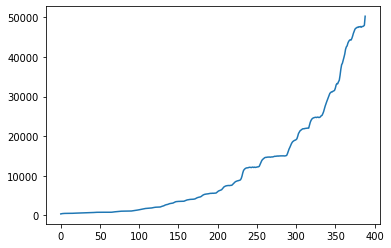

In [14]:
import matplotlib.pyplot as plt

plt.plot(ave_wt)
plt.show()

In [15]:
import time
from random import randint, randrange

def fitness(cmb, atm):
    g = 0
    for i, j in zip(cmb, atm):
        if i == j:
            g += 1
    return g

def main():
    combination = '6822858902'
    print("Combination = {}".format(combination))
    combo = [int(i) for i in combination]
    best_a = [0] * len(combo)
    best_a_g = fitness(combo, best_a)
    count = 0
    # evolve guess           
    while best_a != combo:
        # crossover
        next_try = best_a[:]
        # mutate
        lock_wheel = randrange(0, len(combo))
        next_try[lock_wheel] = randint(0, 9)
        # grade & select
        next_try_g = fitness(combo, next_try)
        if next_try_g > best_a_g:
            best_a = next_try[:]
            best_a_g = next_try_g
        print(next_try, best_a)
        count += 1

    print("Cracked! {}".format(best_a), end=' ')
    print("in {} tries!".format(count))

 
start_time = time.time()
main()
end_time = time.time()
duration = end_time - start_time
print("\n{:.5f} seconds.".format(duration))      

Combination = 6822858902
[8, 0, 0, 0, 0, 0, 0, 0, 0, 0] [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 3] [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 3, 0, 0, 0, 0, 0] [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 0, 0, 4, 0, 0] [0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 5, 0, 0, 0, 0] [0, 0, 0, 0, 0, 5, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 5, 0, 0, 0, 0] [0, 0, 0, 0, 0, 5, 0, 0, 0, 0]
[0, 0, 4, 0, 0, 5, 0, 0, 0, 0] [0, 0, 0, 0, 0, 5, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 5, 5, 0, 0, 0] [0, 0, 0, 0, 0, 5, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 5, 0, 0, 0, 6] [0, 0, 0, 0, 0, 5, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 1, 0, 0, 0, 0] [0, 0, 0, 0, 0, 5, 0, 0, 0, 0]
[5, 0, 0, 0, 0, 5, 0, 0, 0, 0] [0, 0, 0, 0, 0, 5, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 5, 0, 0, 2, 0] [0, 0, 0, 0, 0, 5, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 5, 0, 0, 0, 1] [0, 0, 0, 0, 0, 5, 0, 0, 0, 0]
[0, 0, 0, 8, 0, 5, 0, 0, 0, 0] [0, 0, 0, 0, 0, 5, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 5, 0, 0, 5, 0] [0, 0, 0, 0, 0, 5, 0, 0, 0, 0]
[0, 0, 0, 0, 0, 5, 0, 0, 0, 1] [0, 0, 0, 0, 0

# Chap8

In [16]:
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_8/missing_words.json

--2020-08-20 10:45:14--  https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_8/missing_words.json
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 894 [text/plain]
Saving to: ‘missing_words.json’

missing_words.json  100%[===================>]     894  --.-KB/s    in 0s      

2020-08-20 10:45:15 (52.4 MB/s) - ‘missing_words.json’ saved [894/894]



In [17]:
!pip install nltk

In [18]:
import sys
from string import punctuation
import json
from nltk.corpus import cmudict
import nltk 
nltk.download('cmudict')

with open('missing_words.json') as f:
    missing_words = json.load(f)

cmudict = cmudict.dict()

def count_syllables(words):
    words = words.replace('-', ' ')
    words = words.lower().split()
    num_sylls = 0
    for word in words:
        word = word.strip(punctuation)
        if word.endswith("'s")or word.endswith("’s"):
            word = word[:-2]
        if word in missing_words:
            num_sylls += missing_words[word]
        else:
            for phonemes in cmudict[word][0]:
                for phoneme in phonemes:
                    if phoneme[-1].isdigit():
                        num_sylls += 1
    return num_sylls

[nltk_data] Downloading package cmudict to /root/nltk_data...
[nltk_data]   Unzipping corpora/cmudict.zip.


In [19]:
import sys
import random

def load(file):
    with open(file) as in_file:
        txt = in_file.read().strip().split('\n')
        txt = [x.lower() for x in txt]
        return txt

word_list = load('2of4brif.txt')
test_data = []
num_words = 100
test_data.extend(random.sample(word_list, num_words))

for word in test_data:
    try:
        num_syllables = count_syllables(word)
        print(word, num_syllables, end='\n')
    except KeyError:
        print(word, end='')
        # print(" not found", file=sys.stderr)

bolted 2
classiestchew 1
pondering 3
supplements 3
hellish 2
monstrous 2
assistant 3
magnifies 3
automate 3
deliberative 5
blindsided 3
rites 1
coverletsstockpiles 2
immigrants 3
insubordinate 5
reaffirms 3
initiate 4
typographicsearchlight 2
overboard 3
presenting 3
cannonadesperpetrate 3
vetchcobbled 2
retorted 3
plagiaristsnewspaper 3
accessorize 4
misdeed 2
scripts 1
vigourovertaxed 3
incident 3
intimation 4
marauder 3
supernova 4
sensitisesquadrant 2
misjudged 2
clinkspredecessors 4
dungareesfavouredconsciousness 3
response 2
gallon 2
configuration 5
deemingcavity 3
pulletsinterdicting 4
places 2
hoarieroddballs 2
secure 2
headstrong 2
fireguardsrefutes 2
faggeddistressingly 4
offensivenesssnuff 1
daunt 1
vindicates 3
friendship 2
traveller 3
unnoticed 3
liveried 2
snootinessprominent 3
selfishness 3
tuner 2
vacationers 4
demotion 3
pancreas 3
coltishpolluting 3
crevice 2
attractively 4
attestationstopgap 2
auctioneers 3
sized 1
weeks 1
arightseamedflagonsidoliseyouthful 2
portabl

# Chap9


In [20]:
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_9/train.txt

--2020-08-20 10:45:28--  https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_9/train.txt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 368928 (360K) [text/plain]
Saving to: ‘train.txt’

train.txt           100%[===================>] 360.28K  --.-KB/s    in 0.07s   

2020-08-20 10:45:28 (5.34 MB/s) - ‘train.txt’ saved [368928/368928]



In [21]:
"""Produce new haiku from training corpus of existing haiku."""
import sys
import logging
import random
from collections import defaultdict

logging.disable(logging.CRITICAL)  # comment-out to enable debugging messages
logging.basicConfig(level=logging.DEBUG, format='%(message)s')

def load_training_file(file):
    """Return a text file as a string."""
    with open(file) as f:
        raw_haiku = f.read()
        return raw_haiku

def prep_training(raw_haiku):
    """Load string, remove newline, split words on spaces, and return list."""
    corpus = raw_haiku.replace('\n', ' ').split()
    return corpus

def map_word_to_word(corpus):
    """Load list & use dictionary to map word to word that follows."""
    limit = len(corpus)-1
    dict1_to_1 = defaultdict(list)
    for index, word in enumerate(corpus):
        if index < limit:
            suffix = corpus[index + 1]
            dict1_to_1[word].append(suffix)
    logging.debug("map_word_to_word results for \"sake\" = %s\n", 
                  dict1_to_1['sake'])
    return dict1_to_1

def map_2_words_to_word(corpus):
    """Load list & use dictionary to map word-pair to trailing word."""
    limit = len(corpus)-2
    dict2_to_1 = defaultdict(list)
    for index, word in enumerate(corpus):
        if index < limit:
            key = word + ' ' + corpus[index + 1]
            suffix = corpus[index + 2]
            dict2_to_1[key].append(suffix)
    logging.debug("map_2_words_to_word results for \"sake jug\" = %s\n",
                  dict2_to_1['sake jug'])
    return dict2_to_1

def random_word(corpus):
    """Return random word and syllable count from training corpus."""
    word = random.choice(corpus)
    num_syls = count_syllables(word)
    if num_syls > 4:
        random_word(corpus)
    else:
        logging.debug("random word & syllables = %s %s\n", word, num_syls)
        return (word, num_syls)

def word_after_single(prefix, suffix_map_1, current_syls, target_syls):
    """Return all acceptable words in a corpus that follow a single word."""
    accepted_words = []
    suffixes = suffix_map_1.get(prefix)
    if suffixes != None:
        for candidate in suffixes:
            num_syls = count_syllables(candidate)
            if current_syls + num_syls <= target_syls:
                accepted_words.append(candidate)
    logging.debug("accepted words after \"%s\" = %s\n",
                  prefix, set(accepted_words))
    return accepted_words


def word_after_double(prefix, suffix_map_2, current_syls, target_syls):
    """Return all acceptable words in a corpus that follow a word pair."""
    accepted_words = []
    suffixes = suffix_map_2.get(prefix)
    if suffixes != None:
        for candidate in suffixes:
            num_syls = count_syllables(candidate)
            if current_syls + num_syls <= target_syls:
                accepted_words.append(candidate)
    logging.debug("accepted words after \"%s\" = %s\n",
                  prefix, set(accepted_words))
    return accepted_words

def haiku_line(suffix_map_1, suffix_map_2, corpus, end_prev_line, target_syls):
    """Build a haiku line from a training corpus and return it."""
    line = '2/3'
    line_syls = 0
    current_line = []

    if len(end_prev_line) == 0:  # build first line
        line = '1'
        word, num_syls = random_word(corpus)
        current_line.append(word)
        line_syls += num_syls
        word_choices = word_after_single(word, suffix_map_1,
                                         line_syls, target_syls)
        while len(word_choices) == 0:
            prefix = random.choice(corpus)
            logging.debug("new random prefix = %s", prefix)
            word_choices = word_after_single(prefix, suffix_map_1,
                                             line_syls, target_syls)
        word = random.choice(word_choices)
        num_syls = count_syllables(word)
        logging.debug("word & syllables = %s %s", word, num_syls)
        line_syls += num_syls
        current_line.append(word)
        if line_syls == target_syls:
            end_prev_line.extend(current_line[-2:])
            return current_line, end_prev_line

    else:  # build lines 2 & 3
        current_line.extend(end_prev_line)

    while True:
        logging.debug("line = %s\n", line)
        prefix = current_line[-2] + ' ' + current_line[-1]
        word_choices = word_after_double(prefix, suffix_map_2,
                                         line_syls, target_syls)
        while len(word_choices) == 0:
            index = random.randint(0, len(corpus) - 2)
            prefix = corpus[index] + ' ' + corpus[index + 1]
            logging.debug("new random prefix = %s", prefix)
            word_choices = word_after_double(prefix, suffix_map_2,
                                             line_syls, target_syls)
        word = random.choice(word_choices)
        num_syls = count_syllables(word)
        logging.debug("word & syllables = %s %s", word, num_syls)
        
        if line_syls + num_syls > target_syls:
            continue
        elif line_syls + num_syls < target_syls:
            current_line.append(word)
            line_syls += num_syls
        elif line_syls + num_syls == target_syls:
            current_line.append(word)
            break

    end_prev_line = []
    end_prev_line.extend(current_line[-2:])

    if line == '1':
        final_line = current_line[:]
    else:
        final_line = current_line[2:]

    return final_line, end_prev_line


def main():
    """Give user choice of building a haiku or modifying an existing haiku."""
    intro = """\n
    A thousand monkeys at a thousand typewriters...
    or one computer...can sometimes produce a haiku.\n"""
    print("{}".format(intro))

    raw_haiku = load_training_file("train.txt")
    corpus = prep_training(raw_haiku)
    suffix_map_1 = map_word_to_word(corpus)
    suffix_map_2 = map_2_words_to_word(corpus)
    final = []

    choice = None
    while choice != "0":

        print(
            """
            Japanese Haiku Generator
            0 - Quit
            1 - Generate a Haiku poem
            2 - Regenerate Line 2
            3 - Regenerate Line 3
            """
            )

        choice = input("Choice: ")
        print()

        # exit
        if choice == "0":
            print("Sayonara.")
            sys.exit()

        # generate a full haiku
        elif choice == "1":
            final = []
            end_prev_line = []
            first_line, end_prev_line1 = haiku_line(suffix_map_1, suffix_map_2,
                                                    corpus, end_prev_line, 5)
            final.append(first_line)
            line, end_prev_line2 = haiku_line(suffix_map_1, suffix_map_2,
                                              corpus, end_prev_line1, 7)
            final.append(line)
            line, end_prev_line3 = haiku_line(suffix_map_1, suffix_map_2,
                                              corpus, end_prev_line2, 5)
            final.append(line)

        # regenerate line 2
        elif choice == "2":
            if not final:
                print("Please generate a full haiku first (Option 1).")
                continue
            else:
                line, end_prev_line2 = haiku_line(suffix_map_1, suffix_map_2,
                                                  corpus, end_prev_line1, 7)
                final[1] = line

        # regenerate line 3
        elif choice == "3":
            if not final:
                print("Please generate a full haiku first (Option 1).")
                continue
            else:
                line, end_prev_line3 = haiku_line(suffix_map_1, suffix_map_2,
                                                  corpus, end_prev_line2, 5)
                final[2] = line

        # some unknown choice
        else:
            print("\nSorry, but that isn't a valid choice.", file=sys.stderr)
            continue

        # display results
        print()
        print("First line = ", end="")
        print(' '.join(final[0]), file=sys.stderr)
        print("Second line = ", end="")
        print(" ".join(final[1]), file=sys.stderr)
        print("Third line = ", end="")
        print(" ".join(final[2]), file=sys.stderr)
        print()

    input("\n\nPress the Enter key to exit.")


main()



    A thousand monkeys at a thousand typewriters...
    or one computer...can sometimes produce a haiku.


            Japanese Haiku Generator
            0 - Quit
            1 - Generate a Haiku poem
            2 - Regenerate Line 2
            3 - Regenerate Line 3
            
Choice: 1


dark hands of life the
fragrance of plums: carrying
me back to earth a




First line = Second line = Third line = 

            Japanese Haiku Generator
            0 - Quit
            1 - Generate a Haiku poem
            2 - Regenerate Line 2
            3 - Regenerate Line 3
            
Choice: 2


dark hands of life the
fragrance of plums: carrying
me back to earth a




First line = Second line = Third line = 

            Japanese Haiku Generator
            0 - Quit
            1 - Generate a Haiku poem
            2 - Regenerate Line 2
            3 - Regenerate Line 3
            
Choice: 1


a day in spring oh
sorry tom cat bigger thrust
the half-ends of worms




First line = Second line = Third line = 

            Japanese Haiku Generator
            0 - Quit
            1 - Generate a Haiku poem
            2 - Regenerate Line 2
            3 - Regenerate Line 3
            
Choice: 3


a day in spring oh
sorry tom cat bigger thrust
white before blue night




First line = Second line = Third line = 

            Japanese Haiku Generator
            0 - Quit
            1 - Generate a Haiku poem
            2 - Regenerate Line 2
            3 - Regenerate Line 3
            
Choice: 0

Sayonara.


SystemExit: ignored

/usr/local/lib/python3.6/dist-packages/IPython/core/interactiveshell.py:2890: UserWarning: To exit: use 'exit', 'quit', or Ctrl-D.
  warn("To exit: use 'exit', 'quit', or Ctrl-D.", stacklevel=1)


# Chap10

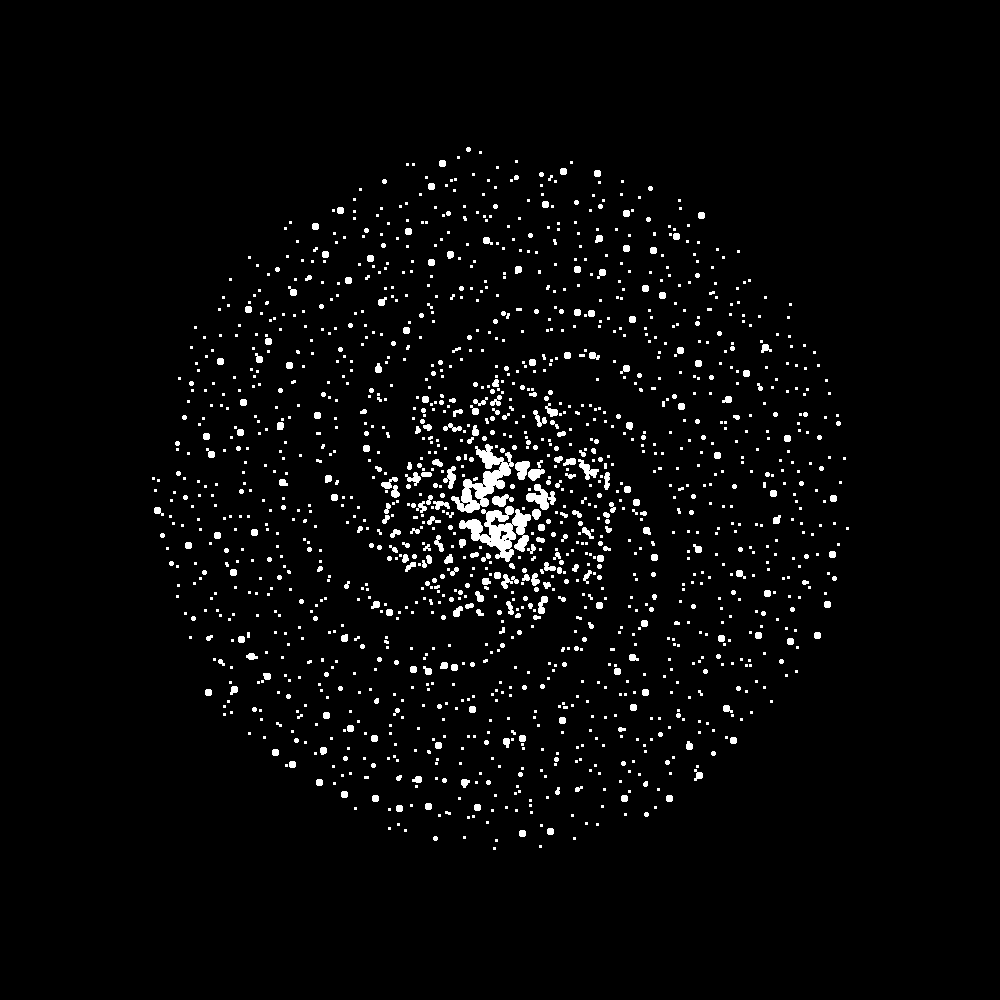

In [22]:
import math
from random import randint
import tkinter
from PIL import Image, ImageDraw

width = 1000
height = 1000
bg='black'

# root = tkinter.Tk()
# root.title("Galaxy BR549")
# cv = tkinter.Canvas(root, width=width, height=height, bg=bg)
image1 = Image.new("RGB", (width, height), bg)
draw = ImageDraw.Draw(image1)

# cv.grid()
# cv.configure(scrollregion=(-500, -400, 500, 400))
x_add = 500
y_add = 500
oval_size = 0

# build spiral arms
num_spiral_stars = 500
angle = 3.5
core_diameter = 120
spiral_stars = []
for i in range(num_spiral_stars):
    theta = i * angle
    r = math.sqrt(i) / math.sqrt(num_spiral_stars)
    spiral_stars.append((r * math.cos(theta), r * math.sin(theta)))
for x, y in spiral_stars:
    x = x * 350 + randint(-5, 3)
    y = y * 350 + randint(-5, 3)
    oval_size = randint(1, 3)
#    cv.create_oval(x-oval_size, y-oval_size, x+oval_size, y+oval_size,
#                  fill='white', outline='')
    draw.ellipse([x-oval_size+x_add, y-oval_size+y_add, 
                  x+oval_size+x_add, y+oval_size+y_add], 'white')
        
# build wisps
wisps = []
for i in range(2000):
    theta = i * angle
    # divide by num_spiral_stars for better dust lanes
    r = math.sqrt(i) / math.sqrt(num_spiral_stars)
    spiral_stars.append((r * math.cos(theta), r * math.sin(theta)))
for x, y in spiral_stars:
    x = x * 330 + randint(-15, 10)
    y = y * 330 + randint(-15, 10)
    h = math.sqrt(x**2 + y**2)
    if h < 350:
        wisps.append((x, y))
#         cv.create_oval(x-1, y-1, x+1, y+1, fill='white', outline='')  
        draw.ellipse([x-1+x_add, y-1+y_add, x+1+y_add, y+1+y_add], 'white')        
    
# build galactic core 
core = []
for i in range(900):
    x = randint(-core_diameter, core_diameter)
    y = randint(-core_diameter, core_diameter)
    h = math.sqrt(x**2 + y**2)
    if h < core_diameter - 70:
        core.append((x, y))
        oval_size = randint(2, 4)
        # cv.create_oval(x-oval_size, y-oval_size, x+oval_size, y+oval_size,
        #               fill='white', outline='')
        draw.ellipse([x-oval_size+x_add, y-oval_size+y_add, 
                      x+oval_size+x_add, y+oval_size+y_add], 'white') 
    elif h < core_diameter:
        core.append((x, y))
        oval_size = randint(0, 2)
        # cv.create_oval(x-oval_size, y-oval_size, x+oval_size, y+oval_size,
        #               fill='white', outline='')
        draw.ellipse([x-oval_size+x_add, y-oval_size+y_add, 
                      x+oval_size+x_add, y+oval_size+y_add], 'white')
# cv.pack()
# root.mainloop()

# cv.update()
# cv.postscript(file="file_name.ps", colormode='color')

# root.mainloop()
image1.save('./galaxy_practice.jpg')
image1

# Chap11

クラスに同じ誕生日の人がいる確率は70%くらいなんだよっていうものを実装

In [23]:
import random

max_people = 50
num_runs = 2000

print('2人以上が同じ誕生日である確率')

for people in range(2, max_people + 1):
    found_shared = 0
    for run in range(num_runs):
        bdays = []
        for i in range(0, people):
            bday = random.randrange(0, 364)
            bdays.append(bday)               
        set_of_bdays = set(bdays)
        if len(set_of_bdays) < len(bdays):
            found_shared += 1  
    prob = found_shared/num_runs
    print('部屋に{}人しかいないときの確率は{:.4f}'.format(people, prob))

2人以上が同じ誕生日である確率
部屋に2人しかいないときの確率は0.0025
部屋に3人しかいないときの確率は0.0070
部屋に4人しかいないときの確率は0.0180
部屋に5人しかいないときの確率は0.0295
部屋に6人しかいないときの確率は0.0415
部屋に7人しかいないときの確率は0.0625
部屋に8人しかいないときの確率は0.0750
部屋に9人しかいないときの確率は0.1025
部屋に10人しかいないときの確率は0.1285
部屋に11人しかいないときの確率は0.1535
部屋に12人しかいないときの確率は0.1785
部屋に13人しかいないときの確率は0.1880
部屋に14人しかいないときの確率は0.2530
部屋に15人しかいないときの確率は0.2600
部屋に16人しかいないときの確率は0.2990
部屋に17人しかいないときの確率は0.3185
部屋に18人しかいないときの確率は0.3545
部屋に19人しかいないときの確率は0.3760
部屋に20人しかいないときの確率は0.4250
部屋に21人しかいないときの確率は0.4590
部屋に22人しかいないときの確率は0.4675
部屋に23人しかいないときの確率は0.5140
部屋に24人しかいないときの確率は0.5370
部屋に25人しかいないときの確率は0.5620
部屋に26人しかいないときの確率は0.6120
部屋に27人しかいないときの確率は0.6335
部屋に28人しかいないときの確率は0.6650
部屋に29人しかいないときの確率は0.6690
部屋に30人しかいないときの確率は0.7110
部屋に31人しかいないときの確率は0.7425
部屋に32人しかいないときの確率は0.7545
部屋に33人しかいないときの確率は0.7725
部屋に34人しかいないときの確率は0.8005
部屋に35人しかいないときの確率は0.8215
部屋に36人しかいないときの確率は0.8320
部屋に37人しかいないときの確率は0.8545
部屋に38人しかいないときの確率は0.8555
部屋に39人しかいないときの確率は0.8850
部屋に40人しかいないときの確率は0.9005
部屋に41人しかいないときの確率は0.9120
部屋に42人しかいないときの確率は0.9175
部屋に43人しか

# Chap12

In [24]:
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_12/10-yr_TBond_returns_1926-2013_pct.txt
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_12/SP500_returns_1926-2013_pct.txt
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_12/3_mo_TBill_rate_1926-2013_pct.txt
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_12/S-B-C_blend_1926-2013_pct.txt
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_12/S-B_blend_1926-2013_pct.txt
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_12/annual_infl_rate_1926-2013_pct.txt

--2020-08-20 10:46:30--  https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_12/10-yr_TBond_returns_1926-2013_pct.txt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 650 [text/plain]
Saving to: ‘10-yr_TBond_returns_1926-2013_pct.txt’

10-yr_TBond_returns 100%[===================>]     650  --.-KB/s    in 0s      

2020-08-20 10:46:30 (34.4 MB/s) - ‘10-yr_TBond_returns_1926-2013_pct.txt’ saved [650/650]

--2020-08-20 10:46:31--  https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_12/SP500_returns_1926-2013_pct.txt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|1

In [25]:
import sys
import random
import matplotlib.pyplot as plt

def read_to_list(file_name):
    with open(file_name) as in_file:
        lines = [float(line.strip()) for line in in_file]
        decimal = [round(line / 100, 5) for line in lines]
        return decimal

def default_input(prompt, default=None):
    prompt = '{} [{}]: '.format(prompt, default)
    response = input(prompt)
    if not response and default:
        return default
    else:
        return response

# load data files with original data in percent form
print("\nNote: Input data should be in percent, not decimal!\n")
try:
    bonds = read_to_list('10-yr_TBond_returns_1926-2013_pct.txt')
    stocks = read_to_list('SP500_returns_1926-2013_pct.txt')
    blend_40_50_10 = read_to_list('S-B-C_blend_1926-2013_pct.txt')
    blend_50_50 = read_to_list('S-B_blend_1926-2013_pct.txt')
    infl_rate = read_to_list('annual_infl_rate_1926-2013_pct.txt')
except IOError as e:
    print("{}. \nTerminating program.".format(e), file=sys.stderr)
    sys.exit(1)

# get user input; use dictionary for investment-type arguments   
investment_type_args = {'bonds': bonds, 'stocks': stocks,
                        'sb_blend': blend_50_50, 'sbc_blend': blend_40_50_10}

# print input legend for user
print("   stocks = SP500")
print("    bonds = 10-yr Treasury Bond")
print(" sb_blend = 50% SP500/50% TBond")
print("sbc_blend = 40% SP500/50% TBond/10% Cash\n")

print("Press ENTER to take default value shown in [brackets]. \n")

# get user input
invest_type = default_input("Enter investment type: (stocks, bonds, sb_blend,"\
                     " sbc_blend): \n", 'bonds').lower()
while invest_type not in investment_type_args:
    invest_type = input("Invalid investment. Enter investment type " \
                    "as listed in prompt: ")

start_value = default_input("Input starting value of investments: \n", \
                             '2000000')
while not start_value.isdigit():
    start_value = input("Invalid input! Input integer only: ")

withdrawal_1 = default_input("Input annual pre-tax withdrawal for " \
                            "first 5 yrs(today's $): \n", '100000')
while not withdrawal_1.isdigit():
    withdrawal_1 = input("Invalid input! Input integer only: ")

withdrawal_2 = default_input("Input annual pre-tax withdrawal for " \
                            "remainder (today's $): \n", '80000')
while not withdrawal_2.isdigit():
    withdrawal_2 = input("Invalid input! Input integer only: ")

min_years = default_input("Input minimum years in retirement: \n", '18')
while not min_years.isdigit():
    min_years = input("Invalid input! Input integer only: ")

most_likely_years = default_input("Input most-likely years in retirement: \n",
                                  '25')
while not most_likely_years.isdigit():
    most_likely_years = input("Invalid input! Input integer only: ")

max_years = default_input("Input maximum years in retirement: \n", '40')
while not max_years.isdigit():
    max_years = input("Invalid input! Input integer only: ")
    
num_cases = default_input("Input number of cases to run: \n", '50000')
while not num_cases.isdigit():
    num_cases = input("Invalid input! Input integer only: ")

# check for other erroneous input
if not int(min_years) < int(most_likely_years) < int(max_years) \
   or int(max_years) > 99:
    print("\nProblem with input years.", file=sys.stderr)
    print("Requires Min < ML < Max & Max <= 99.", file=sys.stderr)
    sys.exit(1)
   
def montecarlo(returns):
    """Run MCS & return investment value at death & and # of times bankrupt."""
    case_count = 0
    bankrupt_count = 0
    outcome = []

    while case_count < int(num_cases):
        investments = int(start_value)
        start_year = random.randrange(0, len(returns))        
        duration = int(random.triangular(int(min_years), int(max_years),
                                         int(most_likely_years)))       
        end_year = start_year + duration 
        lifespan = [i for i in range(start_year, end_year)]
        bankrupt = 'no'

        # build temporary lists for each case
        lifespan_returns = []
        lifespan_infl = []
        for i in lifespan:
            lifespan_returns.append(returns[i % len(returns)])
            lifespan_infl.append(infl_rate[i % len(infl_rate)])
            
        # loop through each year of retirement for each case run
        for index, i in enumerate(lifespan_returns):
            infl = lifespan_infl[index]

            # don't adjust for inflation the first year
            if index == 0:
                withdraw_infl_adj_1 = int(withdrawal_1)
                withdraw_infl_adj_2 = int(withdrawal_2)
            else:
                withdraw_infl_adj_1 = int(withdraw_infl_adj_1 * (1 + infl))
                withdraw_infl_adj_2 = int(withdraw_infl_adj_2 * (1 + infl))

            if index < 5:
                withdraw_infl_adj = withdraw_infl_adj_1
            else:
                withdraw_infl_adj = withdraw_infl_adj_2

            investments -= withdraw_infl_adj
            investments = int(investments * (1 + i))

            if investments <= 0:
                bankrupt = 'yes'
                break

        if bankrupt == 'yes':
            outcome.append(0)
            bankrupt_count += 1
        else:
            outcome.append(investments)
            
        case_count += 1

    return outcome, bankrupt_count

def bankrupt_prob(outcome, bankrupt_count):
    """Calculate & return chance of running out of money & print statistics."""
    total = len(outcome)
    odds = round(100 * bankrupt_count / total, 1)

    print("\nInvestment type: {}".format(invest_type))
    print("Starting value: ${:,}".format(int(start_value)))
    print("Annual withdrawal first 5 yrs: ${:,}".format(int(withdrawal_1)))
    print("Annual withdrawal after 5 yrs: ${:,}".format(int(withdrawal_2))) 
    print("Years in retirement (min-ml-max): {}-{}-{}"
          .format(min_years, most_likely_years, max_years))
    print("Number of runs: {:,}\n".format(len(outcome)))
    print("Odds of running out of money: {}%\n".format(odds))
    print("Average outcome: ${:,}".format(int(sum(outcome) / total)))
    print("Minimum outcome: ${:,}".format(min(i for i in outcome)))
    print("Maximum outcome: ${:,}".format(max(i for i in outcome)))

    return odds


Note: Input data should be in percent, not decimal!

   stocks = SP500
    bonds = 10-yr Treasury Bond
 sb_blend = 50% SP500/50% TBond
sbc_blend = 40% SP500/50% TBond/10% Cash

Press ENTER to take default value shown in [brackets]. 

Enter investment type: (stocks, bonds, sb_blend, sbc_blend): 
 [bonds]: bonds
Input starting value of investments: 
 [2000000]: 2000000
Input annual pre-tax withdrawal for first 5 yrs(today's $): 
 [100000]: 100000
Input annual pre-tax withdrawal for remainder (today's $): 
 [80000]: 80000
Input minimum years in retirement: 
 [18]: 18
Input most-likely years in retirement: 
 [25]: 25
Input maximum years in retirement: 
 [40]: 40
Input number of cases to run: 
 [50000]: 50000



Investment type: bonds
Starting value: $2,000,000
Annual withdrawal first 5 yrs: $100,000
Annual withdrawal after 5 yrs: $80,000
Years in retirement (min-ml-max): 18-25-40
Number of runs: 50,000

Odds of running out of money: 42.4%

Average outcome: $1,455,728
Minimum outcome: $0
Maximum outcome: $14,033,611


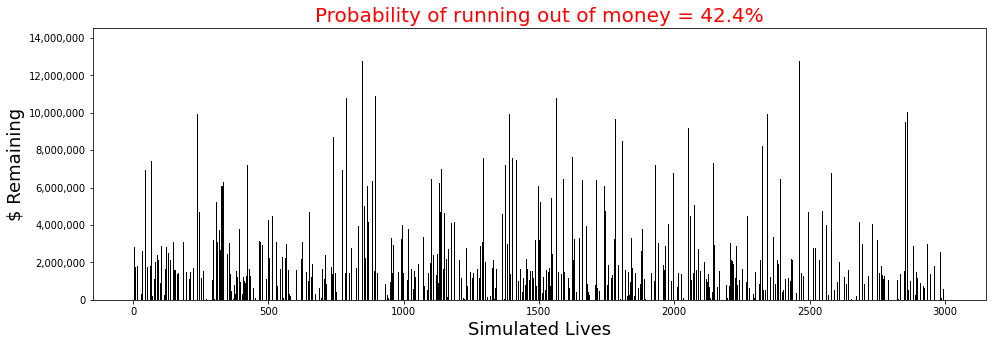

In [26]:
outcome, bankrupt_count = montecarlo(investment_type_args[invest_type])
odds = bankrupt_prob(outcome, bankrupt_count)

# generate matplotlib bar chart 
plotdata = outcome[:3000]  # only plot first 3000 runs
plt.figure('Outcome by Case (showing first {} runs)'.format(len(plotdata)),
           figsize=(16, 5))  # size is width, height in inches
index = [i + 1 for i in range(len(plotdata))]
plt.bar(index, plotdata, color='black')
plt.xlabel('Simulated Lives', fontsize=18)
plt.ylabel('$ Remaining', fontsize=18)
plt.ticklabel_format(style='plain', axis='y')
ax = plt.gca()
ax.get_yaxis().set_major_formatter(plt.FuncFormatter(lambda x, loc: "{:,}"
                                                     .format(int(x))))
plt.title('Probability of running out of money = {}%'.format(odds),
          fontsize=20, color='red')
plt.show()

# Chap13

In [27]:
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_13/tvashtar_plume.gif

--2020-08-20 10:47:28--  https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_13/tvashtar_plume.gif
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 14789 (14K) [image/gif]
Saving to: ‘tvashtar_plume.gif’

tvashtar_plume.gif  100%[===================>]  14.44K  --.-KB/s    in 0.01s   

2020-08-20 10:47:28 (1.14 MB/s) - ‘tvashtar_plume.gif’ saved [14789/14789]



In [28]:
!mkdir particles

In [29]:
!apt install xvfb
!pip install pyvirtualdisplay
!pip install pygame

Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following package was automatically installed and is no longer required:
  libnvidia-common-440
Use 'apt autoremove' to remove it.
The following NEW packages will be installed:
  xvfb
0 upgraded, 1 newly installed, 0 to remove and 35 not upgraded.
Need to get 784 kB of archives.
After this operation, 2,266 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic-updates/universe amd64 xvfb amd64 2:1.19.6-1ubuntu4.4 [784 kB]
Fetched 784 kB in 1s (1,125 kB/s)
Selecting previously unselected package xvfb.
(Reading database ... 144487 files and directories currently installed.)
Preparing to unpack .../xvfb_2%3a1.19.6-1ubuntu4.4_amd64.deb ...
Unpacking xvfb (2:1.19.6-1ubuntu4.4) ...
Setting up xvfb (2:1.19.6-1ubuntu4.4) ...
Processing triggers for man-db (2.8.3-2ubuntu0.1) ...
     |████████████████████████████████| 11.4MB 2.9MB/s 


In [30]:
from pyvirtualdisplay import Display
d = Display()
d.start()

In [31]:
import sys
import math
import random
import pygame as pg

pg.init()
    
BLACK = (0, 0, 0)
WHITE = (255, 255, 255)
LT_GRAY = (180, 180, 180)
GRAY = (120, 120, 120)
DK_GRAY = (80, 80, 80)

class Particle(pg.sprite.Sprite):

    gases_colors = {'SO2': LT_GRAY, 'CO2': GRAY, 'H2S': DK_GRAY, 'H2O': WHITE}
    
    VENT_LOCATION_XY = (320, 300)  # mouth of volcano
    IO_SURFACE_Y = 308  # y location of Io surface
    GRAVITY = 0.5  # pixels-per-frame   
    VELOCITY_SO2 = 8  # pixels-per-frame
    
    # scalars (SO2 atomic weight/particle atomic weight) used for velocity
    vel_scalar = {'SO2': 1, 'CO2': 1.45, 'H2S': 1.9, 'H2O': 3.6}    
      
    def __init__(self, screen, background):
        super().__init__()
        self.screen = screen
        self.background = background
        self.image = pg.Surface((4, 4))
        self.rect = self.image.get_rect()
        self.gas = random.choice(list(Particle.gases_colors.keys()))
        self.color = Particle.gases_colors[self.gas]
        self.vel = Particle.VELOCITY_SO2 * Particle.vel_scalar[self.gas]      
        self.x, self.y = Particle.VENT_LOCATION_XY
        self.vector()

    def vector(self):
        """Calculate particle vector at launch."""
        orient = random.uniform(60, 120)  # 90 is vertical
        radians = math.radians(orient)
        self.dx = self.vel * math.cos(radians)
        self.dy = -self.vel * math.sin(radians)  # negative as y increases down
        
    def update(self):
        """Apply gravity, draw path, and handle boundary conditions."""
        self.dy += Particle.GRAVITY
        pg.draw.line(self.background, self.color, (self.x, self.y),
                     (self.x + self.dx, self.y + self.dy))
        self.x += self.dx
        self.y += self.dy
        if self.x < 0 or self.x > self.screen.get_width():
            self.kill()
        if self.y < 0 or self.y > Particle.IO_SURFACE_Y:
            self.kill()


pygame 1.9.6
Hello from the pygame community. https://www.pygame.org/contribute.html


In [32]:
screen = pg.display.set_mode((639, 360))
pg.display.set_caption('Io Volcano Simulator')
background = pg.image.load('tvashtar_plume.gif')

# Set-up color-coded legend
legend_font = pg.font.SysFont('None', 24)
water_label = legend_font.render('--- H2O', True, WHITE, BLACK)
co2_label = legend_font.render('--- CO2', True, GRAY, BLACK)
so2_label = legend_font.render('--- SO2/S2', True, LT_GRAY, BLACK)
h2s_label = legend_font.render('--- H2S', True, DK_GRAY, BLACK)

particles = pg.sprite.Group()

clock = pg.time.Clock()

img = []
#while True:
for i in range(100):
    clock.tick(25)
    particles.add(Particle(screen, background))
    for event in pg.event.get():
        if event.type == pg.QUIT:
            pg.quit()
            sys.exit()

    screen.blit(background, (0, 0))
    screen.blit(water_label, (40, 20))
    screen.blit(h2s_label, (40, 40))
    screen.blit(co2_label, (40, 60))
    screen.blit(so2_label, (40, 80))
    particles.update()
    particles.draw(screen)
    pg.image.save(screen, 'particles/particles' + str(i).zfill(4) + '.jpg')
    pg.display.flip()


In [34]:
from PIL import Image, ImageDraw

images = list()
for i in range(100):
  img = Image.open("particles/particles{0:04d}.jpg".format(i))
  images.append(img)
images[0].save('particles.gif',
               save_all=True, append_images=images[1:], optimize=False)

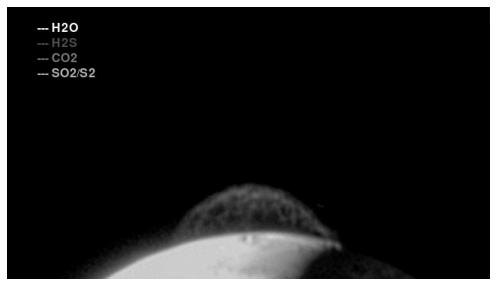

In [35]:
# from JSAnimation.IPython_display import display_animation
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

plt.figure(figsize=(639/72, 360/72), dpi=72)
patch = plt.imshow(images[0])
plt.axis('off')
  
def animate(i):
  patch.set_data(images[i])
    
anim = animation.FuncAnimation(plt.gcf(), animate, frames=len(images), interval=50)
HTML(anim.to_jshtml())

# Chap14

In [36]:
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_14/mars.png
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_14/mars_water.png
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_14/satellite.png
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_14/satellite_crash_40x33.png

--2020-08-20 10:49:36--  https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_14/mars.png
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 410710 (401K) [image/png]
Saving to: ‘mars.png’

mars.png            100%[===================>] 401.08K  --.-KB/s    in 0.07s   

2020-08-20 10:49:37 (5.74 MB/s) - ‘mars.png’ saved [410710/410710]

--2020-08-20 10:49:39--  https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_14/mars_water.png
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 67

In [ ]:
# !apt install xvfb
# !pip install pyvirtualdisplay
# !pip install pygame

In [37]:
from pyvirtualdisplay import Display
d = Display()
d.start()

In [38]:
import os
import math
import random
import pygame as pg

In [39]:
!mkdir mars_orbiter

In [40]:
WHITE = (255, 255, 255)
BLACK = (0, 0, 0)
RED = (255, 0, 0)
GREEN = (0, 255, 0)
LT_BLUE = (173, 216, 230)

class Satellite(pg.sprite.Sprite):
    """Satellite object that rotates to face planet & crashes & burns."""
    
    def __init__(self, background):
        super().__init__()
        self.background = background
        self.image_sat = pg.image.load("satellite.png").convert()
        self.image_crash = pg.image.load("satellite_crash_40x33.png").convert()
        self.image = self.image_sat
        self.rect = self.image.get_rect()
        self.image.set_colorkey(BLACK)  # sets transparent color
        self.x = random.randrange(315, 425)
        self.y = random.randrange(70, 180) 
        self.dx = random.choice([-3, 3])
        self.dy = 0
        self.heading = 0  # initializes dish orientation
        self.fuel = 100
        self.mass = 1
        self.distance = 0  # initializes distance between satellite & planet
        # self.thrust = pg.mixer.Sound('thrust_audio.ogg')
        # self.thrust.set_volume(0.07)  # valid values are 0-1

    def thruster(self, dx, dy):
        """Execute actions associated with firing thrusters."""
        self.dx += dx
        self.dy += dy
        self.fuel -= 2
        # self.thrust.play()     

    def check_keys(self):
        """Check if user presses arrow keys & call thruster() method."""
        keys = pg.key.get_pressed()       
        # fire thrusters
        if keys[pg.K_RIGHT]:
            self.thruster(dx=0.05, dy=0)
        elif keys[pg.K_LEFT]:
            self.thruster(dx=-0.05, dy=0)
        elif keys[pg.K_UP]:
            self.thruster(dx=0, dy=-0.05)  
        elif keys[pg.K_DOWN]:
            self.thruster(dx=0, dy=0.05)
            
    def locate(self, planet):
        """Calculate distance & heading to planet."""
        px, py = planet.x, planet.y
        dist_x = self.x - px
        dist_y = self.y - py
        # get direction to planet to point dish
        planet_dir_radians = math.atan2(dist_x, dist_y)
        self.heading = planet_dir_radians * 180 / math.pi
        self.heading -= 90  # sprite is traveling tail-first       
        self.distance = math.hypot(dist_x, dist_y)

    def rotate(self):
        """Rotate satellite using degrees so dish faces planet."""
        self.image = pg.transform.rotate(self.image_sat, self.heading)
        self.rect = self.image.get_rect()

    def path(self):
        """Update satellite's position & draw line to trace orbital path."""
        last_center = (self.x, self.y)
        self.x += self.dx
        self.y += self.dy
        pg.draw.line(self.background, WHITE, last_center, (self.x, self.y))

    def update(self):
        """Update satellite object during game."""
        self.check_keys()
        self.rotate()
        self.path()
        self.rect.center = (self.x, self.y)        
        # change image to fiery red if in atmosphere
        if self.dx == 0 and self.dy == 0:
            self.image = self.image_crash
            self.image.set_colorkey(BLACK)
            
class Planet(pg.sprite.Sprite):
    """Planet object that rotates & projects gravity field."""
    
    def __init__(self):
        super().__init__()
        self.image_mars = pg.image.load("mars.png").convert()
        self.image_water = pg.image.load("mars_water.png").convert() 
        self.image_copy = pg.transform.scale(self.image_mars, (100, 100)) 
        self.image_copy.set_colorkey(BLACK) 
        self.rect = self.image_copy.get_rect()
        self.image = self.image_copy
        self.mass = 2000 
        self.x = 400 
        self.y = 320
        self.rect.center = (self.x, self.y)
        self.angle = math.degrees(0)
        self.rotate_by = math.degrees(0.01)

    def rotate(self):
        """Rotate the planet image with each game loop."""
        last_center = self.rect.center
        self.image = pg.transform.rotate(self.image_copy, self.angle)
        self.rect = self.image.get_rect()
        self.rect.center = last_center
        self.angle += self.rotate_by

    def gravity(self, satellite):
        """Calculate impact of gravity on the satellite."""
        G = 1.0  # gravitational constant for game
        dist_x = self.x - satellite.x
        dist_y = self.y - satellite.y
        distance = math.hypot(dist_x, dist_y)     
        # normalize to a unit vector
        dist_x /= distance
        dist_y /= distance
        # apply gravity
        force = G * (satellite.mass * self.mass) / (math.pow(distance, 2))
        satellite.dx += (dist_x * force)
        satellite.dy += (dist_y * force)
        
    def update(self):
        """Call the rotate method."""
        self.rotate()

def calc_eccentricity(dist_list):
    """Calculate & return eccentricity from list of radii."""
    apoapsis = max(dist_list)
    periapsis = min(dist_list)
    eccentricity = (apoapsis - periapsis) / (apoapsis + periapsis)
    return eccentricity

def instruct_label(screen, text, color, x, y):
    """Take screen, list of strings, color, & origin & render text to screen."""
    instruct_font = pg.font.SysFont(None, 25)
    line_spacing = 22
    for index, line in enumerate(text):
        label = instruct_font.render(line, True, color, BLACK)
        screen.blit(label, (x, y + index * line_spacing))

def box_label(screen, text, dimensions):
    """Make fixed-size label from screen, text & left, top, width, height."""
    readout_font = pg.font.SysFont(None, 27)
    base = pg.Rect(dimensions)
    pg.draw.rect(screen, WHITE, base, 0)
    label = readout_font.render(text, True, BLACK)
    label_rect = label.get_rect(center=base.center)
    screen.blit(label, label_rect)

def mapping_on(planet):
    """Show soil moisture image on Mars."""
    last_center = planet.rect.center
    planet.image_copy = pg.transform.scale(planet.image_water, (100, 100))
    planet.image_copy.set_colorkey(BLACK)
    planet.rect = planet.image_copy.get_rect()
    planet.rect.center = last_center

def mapping_off(planet):
    """Restore normal planet image."""
    planet.image_copy = pg.transform.scale(planet.image_mars, (100, 100))
    planet.image_copy.set_colorkey(BLACK)

def cast_shadow(screen):
    """Add optional terminator & shadow behind planet to screen."""
    shadow = pg.Surface((400, 100), flags=pg.SRCALPHA)  # tuple is w,h
    shadow.fill((0, 0, 0, 210))  # last number sets transparency
    screen.blit(shadow, (0, 270))  # tuple is top left coordinates



In [41]:
pg.init()  # initialize pygame

# set-up display
os.environ['SDL_VIDEO_WINDOW_POS'] = '700, 100'  # set game window origin
screen = pg.display.set_mode((800, 645), pg.FULLSCREEN) 
pg.display.set_caption("Mars Orbiter")
background = pg.Surface(screen.get_size())

# enable sound mixer
# pg.mixer.init()

intro_text = [
    ' The Mars Orbiter experienced an error during Orbit insertion.',
    ' Use thrusters to correct to a circular mapping orbit without',
    ' running out of propellant or burning up in the atmosphere.'
    ]

instruct_text1 = [
    'Orbital altitude must be within 69-120 miles',
    'Orbital Eccentricity must be < 0.05',
    'Avoid top of atmosphere at 68 miles'    
    ]

instruct_text2 = [
    'Left Arrow = Decrease Dx', 
    'Right Arrow = Increase Dx', 
    'Up Arrow = Decrease Dy', 
    'Down Arrow = Increase Dy', 
    'Space Bar = Clear Path',
    'Escape = Exit Full Screen'        
    ]  

# instantiate planet and satellite objects
planet = Planet()
planet_sprite = pg.sprite.Group(planet)
sat = Satellite(background)    
sat_sprite = pg.sprite.Group(sat)

# for circular orbit verification
dist_list = []  
eccentricity = 1
eccentricity_calc_interval = 5  # optimized for 120 mile altitude

# time-keeping
clock = pg.time.Clock()
fps = 30
tick_count = 0

# for soil moisture mapping functionality
mapping_enabled = False

running = True
# while running:
for i in range(1000):
    clock.tick(fps)
    tick_count += 1
    dist_list.append(sat.distance)
    
    # get keyboard input
    for event in pg.event.get():
        if event.type == pg.QUIT:  # close window
            running = False
        elif event.type == pg.KEYDOWN and event.key == pg.K_ESCAPE:
            screen = pg.display.set_mode((800, 645))  # exit full screen
        elif event.type == pg.KEYDOWN and event.key == pg.K_SPACE:
            background.fill(BLACK)  # clear path
        elif event.type == pg.KEYUP:
            sat.thrust.stop()  # stop sound
            mapping_off(planet)  # turn-off moisture map view
        elif mapping_enabled:
            if event.type == pg.KEYDOWN and event.key == pg.K_m:
                mapping_on(planet)

    # get heading & distance to planet & apply gravity               
    sat.locate(planet)  
    planet.gravity(sat)

    # calculate orbital eccentricity
    if tick_count % (eccentricity_calc_interval * fps) == 0:
        eccentricity = calc_eccentricity(dist_list)
        dist_list = []              

    # re-blit background for drawing command - prevents clearing path
    screen.blit(background, (0, 0))
    
    # Fuel/Altitude fail conditions
    if sat.fuel <= 0:
        instruct_label(screen, ['Fuel Depleted!'], RED, 340, 195)
        sat.fuel = 0
        sat.dx = 2
    elif sat.distance <= 68:
        instruct_label(screen, ['Atmospheric Entry!'], RED, 320, 195)
        sat.dx = 0
        sat.dy = 0

    # enable mapping functionality
    if eccentricity < 0.05 and sat.distance >= 69 and sat.distance <= 120:
        map_instruct = ['Press & hold M to map soil moisture']
        instruct_label(screen, map_instruct, LT_BLUE, 250, 175)
        mapping_enabled = True
    else:
        mapping_enabled = False

    planet_sprite.update()
    planet_sprite.draw(screen)
    sat_sprite.update()
    sat_sprite.draw(screen)
    pg.image.save(screen, 'mars_orbiter/mars_orbiter' + str(i).zfill(4) + '.jpg')

    # display intro text for 15 seconds      
    if pg.time.get_ticks() <= 15000:  # time in milliseconds
        instruct_label(screen, intro_text, GREEN, 145, 100)

    # display telemetry and instructions
    box_label(screen, 'Dx', (70, 20, 75, 20))
    box_label(screen, 'Dy', (150, 20, 80, 20))
    box_label(screen, 'Altitude', (240, 20, 160, 20))
    box_label(screen, 'Fuel', (410, 20, 160, 20))
    box_label(screen, 'Eccentricity', (580, 20, 150, 20))
    
    box_label(screen, '{:.1f}'.format(sat.dx), (70, 50, 75, 20))     
    box_label(screen, '{:.1f}'.format(sat.dy), (150, 50, 80, 20))
    box_label(screen, '{:.1f}'.format(sat.distance), (240, 50, 160, 20))
    box_label(screen, '{}'.format(sat.fuel), (410, 50, 160, 20))
    box_label(screen, '{:.8f}'.format(eccentricity), (580, 50, 150, 20))
      
    instruct_label(screen, instruct_text1, WHITE, 10, 575)
    instruct_label(screen, instruct_text2, WHITE, 570, 510)
  
    # add terminator & border
    cast_shadow(screen)
    pg.draw.rect(screen, WHITE, (1, 1, 798, 643), 1)
    pg.display.flip()

In [42]:
from PIL import Image, ImageDraw

images = list()
for i in range(1000):
  img = Image.open("mars_orbiter/mars_orbiter{0:04d}.jpg".format(i))
  images.append(img)
images[0].save('mars_orbiter.gif',
               save_all=True, append_images=images[1:500], optimize=False)

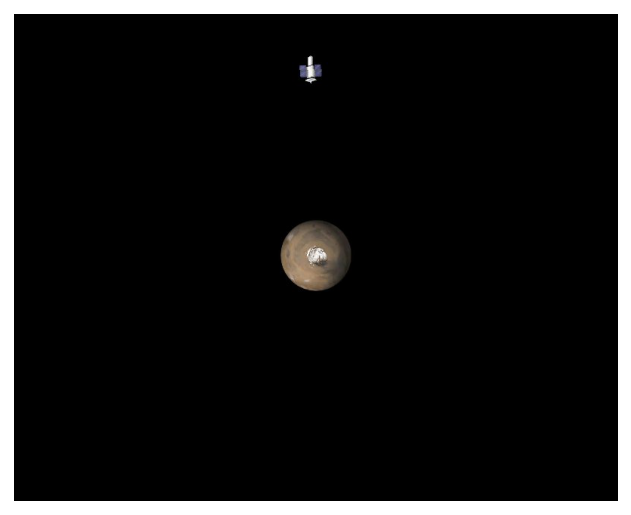

In [43]:
# from JSAnimation.IPython_display import display_animation
import matplotlib.pyplot as plt
from matplotlib import animation
from IPython.display import HTML

plt.figure(figsize=(800/144, 645/144), dpi=144)
patch = plt.imshow(images[0])
plt.axis('off')
  
def animate(i):
  patch.set_data(images[i])
    
anim = animation.FuncAnimation(plt.gcf(), animate, frames=len(images)-500, interval=50)
HTML(anim.to_jshtml())

# Chap15

soon...

# Chap16


In [44]:
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_16/Illinois_votes.txt
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_16/Clinton_votes_Illinois.txt
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_16/Johnson_votes_Illinois.txt
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_16/Trump_votes_Illinois.txt
!wget https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_16/Stein_votes_Illinois.txt

--2020-08-20 10:52:31--  https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_16/Illinois_votes.txt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1893 (1.8K) [text/plain]
Saving to: ‘Illinois_votes.txt’

Illinois_votes.txt  100%[===================>]   1.85K  --.-KB/s    in 0s      

2020-08-20 10:52:31 (33.8 MB/s) - ‘Illinois_votes.txt’ saved [1893/1893]

--2020-08-20 10:52:33--  https://raw.githubusercontent.com/rlvaugh/Impractical_Python_Projects/master/Chapter_16/Clinton_votes_Illinois.txt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 151.101.0.133, 151.101.64.133, 151.101.128.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|151.101.0.133|:443... connected.
HTTP request sent, a

In [45]:
def load_data(filename):
    with open(filename) as f:
        lines = f.read().strip().split('\n')
        return [int(i) for i in lines]

def steal_votes(opponent_votes, candidate_votes, scalar):
    new_opponent_votes = []
    new_candidate_votes = []
    for opp_vote, can_vote in zip(opponent_votes, candidate_votes):
        new_opp_vote = round(opp_vote * scalar)
        new_opponent_votes.append(new_opp_vote)
        stolen_votes = opp_vote - new_opp_vote
        new_can_vote = can_vote + stolen_votes
        new_candidate_votes.append(new_can_vote)
    return new_opponent_votes, new_candidate_votes

In [46]:
# load vote data
c_votes = load_data('Clinton_votes_Illinois.txt')
j_votes = load_data('Johnson_votes_Illinois.txt')
s_votes = load_data('Stein_votes_Illinois.txt')
t_votes = load_data('Trump_votes_Illinois.txt')

total_votes = sum(c_votes + j_votes + s_votes + t_votes)


# assume Trump amasses a plurality of the vote with 49%
t_target = round(total_votes * 0.49)
print("\nTrump winning target = {:,} votes".format(t_target))

# calculate extra votes needed for Trump victory
extra_votes_needed = abs(t_target - sum(t_votes))
print("extra votes needed = {:,}".format(extra_votes_needed))

# calculate scalar needed to generate extra votes
scalar = 1 - (extra_votes_needed / sum(c_votes + j_votes + s_votes))
print("scalar = {:.3}".format(scalar))
print()

# flip vote counts based on scalar & build new combined list of votes
fake_counts = []
new_c_votes, new_t_votes = steal_votes(c_votes, t_votes, scalar)
fake_counts.extend(new_c_votes)
new_j_votes, new_t_votes = steal_votes(j_votes, new_t_votes, scalar)
fake_counts.extend(new_j_votes)
new_s_votes, new_t_votes = steal_votes(s_votes, new_t_votes, scalar)
fake_counts.extend(new_s_votes)
fake_counts.extend(new_t_votes)  # add last as has been changing up til now   

# compare old and new vote counts & totals in tabular form
# switch-out "Trump" and "Clinton" as necessary
for i in range(0, len(t_votes)):
    print("old Trump: {} \t new Trump: {} \t old Clinton: {} \t " \
          "new Clinton: {}".
          format(t_votes[i], new_t_votes[i], c_votes[i], new_c_votes[i]))              
    print("-" * 95)
print("TOTALS:")
print("old Trump: {:,} \t new Trump: {:,} \t old Clinton: {:,}  " \
      "new Clinton: {:,}".format(sum(t_votes), sum(new_t_votes),
                                 sum(c_votes), sum(new_c_votes)))
                               
# write-out a text file to use as input to benford.py program
# this program will check conformance of faked votes to Benford's Law
with open('fake_Illinois_counts.txt', 'w') as f:
    for count in fake_counts:
        f.write("{}\n".format(count))


Trump winning target = 2,706,340 votes
extra votes needed = 560,325
scalar = 0.834

old Trump: 22790 	 new Trump: 24299 	 old Clinton: 7676 	 new Clinton: 6402
-----------------------------------------------------------------------------------------------
old Trump: 1496 	 new Trump: 1715 	 old Clinton: 1262 	 new Clinton: 1053
-----------------------------------------------------------------------------------------------
old Trump: 4888 	 new Trump: 5316 	 old Clinton: 2068 	 new Clinton: 1725
-----------------------------------------------------------------------------------------------
old Trump: 12282 	 new Trump: 14005 	 old Clinton: 8986 	 new Clinton: 7495
-----------------------------------------------------------------------------------------------
old Trump: 1796 	 new Trump: 1890 	 old Clinton: 476 	 new Clinton: 397
-----------------------------------------------------------------------------------------------
old Trump: 9281 	 new Trump: 10454 	 old Clinton: 6029 	 new Cl

In [47]:
import sys
import math
from collections import defaultdict
import matplotlib.pyplot as plt

# Benford's Law percentages for leading digits 1-9
BENFORD = [30.1, 17.6, 12.5, 9.7, 7.9, 6.7, 5.8, 5.1, 4.6]

def load_data(filename):
    with open(filename) as f:
        return f.read().strip().split('\n')
    
def count_first_digits(data_list):
    first_digits = defaultdict(int)  # default value of int is 0
    for sample in data_list:
        if sample == '':
            continue
        try:
            int(sample)
        except ValueError as e:
            print(e, file=sys.stderr)
            print("Samples must be integers. Exiting.", file=sys.stderr)
            sys.exit(1)
        first_digits[sample[0]] += 1  
        
    # check for missing digits
    keys = [str(digit) for digit in range(1, 10)]
    for key in keys:
        if key not in first_digits:
            first_digits[key] = 0
            
    data_count = [v for (k, v) in sorted(first_digits.items())]
    total_count = sum(data_count)
    data_pct = [(i / total_count) * 100 for i in data_count]
    return data_count, data_pct, total_count

def get_expected_counts(total_count):
    return [round(p * total_count / 100) for p in BENFORD]

def chi_square_test(data_count, expected_counts):
    chi_square_stat = 0  # chi square test statistic
    for data, expected in zip(data_count, expected_counts):
        chi_square = math.pow(data - expected, 2)
        chi_square_stat += chi_square / expected
    print("\nChi-squared Test Statistic = {:.3f}".format(chi_square_stat))
    print("Critical value at a P-value of 0.05 is 15.51.")    
    return chi_square_stat < 15.51

def bar_chart(data_pct):
    fig, ax = plt.subplots()

    index = [i + 1 for i in range(len(data_pct))]  # 1st digits for x-axis

    # text for labels, title and ticks
    fig.canvas.set_window_title('Percentage First Digits')
    ax.set_title('Data vs. Benford Values', fontsize=15)
    ax.set_ylabel('Frequency (%)', fontsize=16)
    ax.set_xticks(index)
    ax.set_xticklabels(index, fontsize=14)

    # build bars    
    rects = ax.bar(index, data_pct, width=0.95, color='black', label='Data')

    # attach a text label above each bar displaying its height
    for rect in rects:
        height = rect.get_height()
        ax.text(rect.get_x() + rect.get_width()/2, height,
                '{:0.1f}'.format(height), ha='center', va='bottom', 
                fontsize=13)

    # plot Benford values as red dots
    ax.scatter(index, BENFORD, s=150, c='red', zorder=2, label='Benford')

    # Hide the right and top spines & add legend
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.legend(prop={'size':15}, frameon=False)
    
    plt.show()


In [48]:
def bar_benford(file):
    while True:
        filename = file
        try:
            data_list = load_data(file)
        except IOError as e:
            print("{}. Try again.".format(e), file=sys.stderr)
        else:
            break
    data_count, data_pct, total_count = count_first_digits(data_list)
    expected_counts = get_expected_counts(total_count)
    print("\nobserved counts = {}".format(data_count))
    print("expected counts = {}".format(expected_counts), "\n")

    print("First Digit Probabilities:")
    for i in range(1, 10):
        print("{}: observed: {:.3f}  expected: {:.3f}".
            format(i, data_pct[i - 1] / 100, BENFORD[i - 1] / 100))

    if chi_square_test(data_count, expected_counts):
        print("Observed distribution matches expected distribution.")
    else:
        print("Observed distribution does not match expected.", file=sys.stderr)       

    bar_chart(data_pct)


observed counts = [129, 62, 45, 48, 40, 25, 23, 21, 15]
expected counts = [123, 72, 51, 40, 32, 27, 24, 21, 19] 

First Digit Probabilities:
1: observed: 0.316  expected: 0.301
2: observed: 0.152  expected: 0.176
3: observed: 0.110  expected: 0.125
4: observed: 0.118  expected: 0.097
5: observed: 0.098  expected: 0.079
6: observed: 0.061  expected: 0.067
7: observed: 0.056  expected: 0.058
8: observed: 0.051  expected: 0.051
9: observed: 0.037  expected: 0.046

Chi-squared Test Statistic = 7.019
Critical value at a P-value of 0.05 is 15.51.
Observed distribution matches expected distribution.


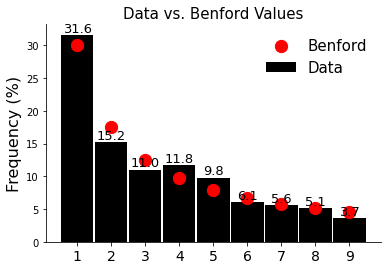

In [49]:
bar_benford('Illinois_votes.txt')


observed counts = [124, 63, 44, 49, 30, 37, 20, 20, 21]
expected counts = [123, 72, 51, 40, 32, 27, 24, 21, 19] 

First Digit Probabilities:
1: observed: 0.304  expected: 0.301
2: observed: 0.154  expected: 0.176
3: observed: 0.108  expected: 0.125
4: observed: 0.120  expected: 0.097
5: observed: 0.074  expected: 0.079
6: observed: 0.091  expected: 0.067
7: observed: 0.049  expected: 0.058
8: observed: 0.049  expected: 0.051
9: observed: 0.051  expected: 0.046

Chi-squared Test Statistic = 8.872
Critical value at a P-value of 0.05 is 15.51.
Observed distribution matches expected distribution.


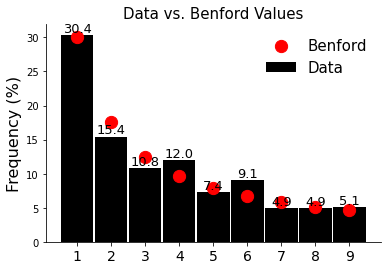

In [50]:
bar_benford('fake_Illinois_counts.txt')